In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches

from milliontrees.datasets.TreePolygons import TreePolygonsDataset

## polygons

dataPolygons = TreePolygonsDataset(download=True,mini=True)
trainPolygons = dataPolygons.get_subset("train")


split_path = "data/TreePolygons_v0.10/random.csv"
split_df = pd.read_csv(split_path)
    
print("Number of rows in split:", len(split_df))



  0%|          | 129564672/106085316699 [00:17<4:00:24, 7345396.57Byte/s]


Extracting data/TreePolygons_v0.10/archive.zip to data/TreePolygons_v0.10

It took 0.32 minutes to download and uncompress the dataset.

Number of rows in split: 6175


In [2]:
split_df.head()

,Unnamed: 0,pixelvalue,Class,Field,Shape_Leng,Shape_Area,NEWSPECIES,OneClass,Code,geometry,...,class_code,taxon_id,Urban_Class_ID,Urban_Class,Street_ID,individual,indiviudal,indiviual,complete,polygon
0,237.0,0.0,AM,0.0,6.988297,2.785392,NaN,tree,ACMIM,"POLYGON ((326.610526 509.021053, 327.831579 56...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,"POLYGON ((326.610526 509.021053, 327.831579 56..."
1,238.0,0.0,AM,0.0,6.307216,2.243685,NaN,tree,ACMIM,"POLYGON ((477.178947 518.810526, 535.936842 59...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,"POLYGON ((477.178947 518.810526, 535.936842 59..."
2,209.0,0.0,AM,0.0,3.945989,1.099880,NaN,tree,ACMIM,"POLYGON ((743.963158 567.026316, 724.310526 55...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,"POLYGON ((743.963158 567.026316, 724.310526 55..."
3,210.0,0.0,AM,0.0,4.183740,1.082917,NaN,tree,ACMIM,"POLYGON ((823.273684 618.963158, 833.8 591.589...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,"POLYGON ((823.273684 618.963158, 833.8 591.589..."
4,235.0,0.0,AM,0.0,6.641302,1.917673,NaN,tree,ACMIM,"POLYGON ((307.021053 652.242105, 363.331579 67...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,"POLYGON ((307.021053 652.242105, 363.331579 67..."


In [ ]:

row = split_df.iloc[0] 
print("Selected row:")
print(row)

image_filename = row["filename"]
poly = row["geometry"]  
images_dir = os.path.join("data", "TreePolygons_v0.10", "images")
image_path = os.path.join(images_dir, image_filename)

print("Image path:", image_path)
assert os.path.exists(image_path), f"Image not found: {image_path}"



Selected row:
Unnamed: 0                                                    237.0
pixelvalue                                                      0.0
Class                                                            AM
Field                                                           0.0
Shape_Leng                                                 6.988297
Shape_Area                                                 2.785392
NEWSPECIES                                                      NaN
OneClass                                                       tree
Code                                                          ACMIM
geometry          POLYGON ((326.610526 509.021053, 327.831579 56...
filename                                 PlotS2_20210621_RGB_62.png
label                                                          Tree
Newspecies                                                      NaN
source                                           Jansen et al. 2023
existing_split                    

In [18]:
import json
from shapely.geometry import shape
import regex as re

img = plt.imread(image_path)

#parsing the geom
numbers = re.findall(r'[-+]?\d*\.\d+|[-+]?\d+', poly)
coords = []
for i in range(0, len(numbers), 2):
    x = float(numbers[i])      
    y = float(numbers[i+1])      
    coords.append((x, y))

print(f"Parsed {len(coords)} coords: {coords[:3]}...")



#geom = shape(json.loads(poly.replace("POLYGON ((", '{"type":"Polygon","coordinates":[[').replace("]))", "]]}")))
#coords = list(geom.exterior.coords)  # [(x1,y1), (x2,y2), ...]

#print(f"Polygon has {len(coords)} points: {coords[:3]}...")


Parsed 6 coords: [(326.610526, 509.021053), (327.831579, 567.778947), (462.489474, 560.431579)]...


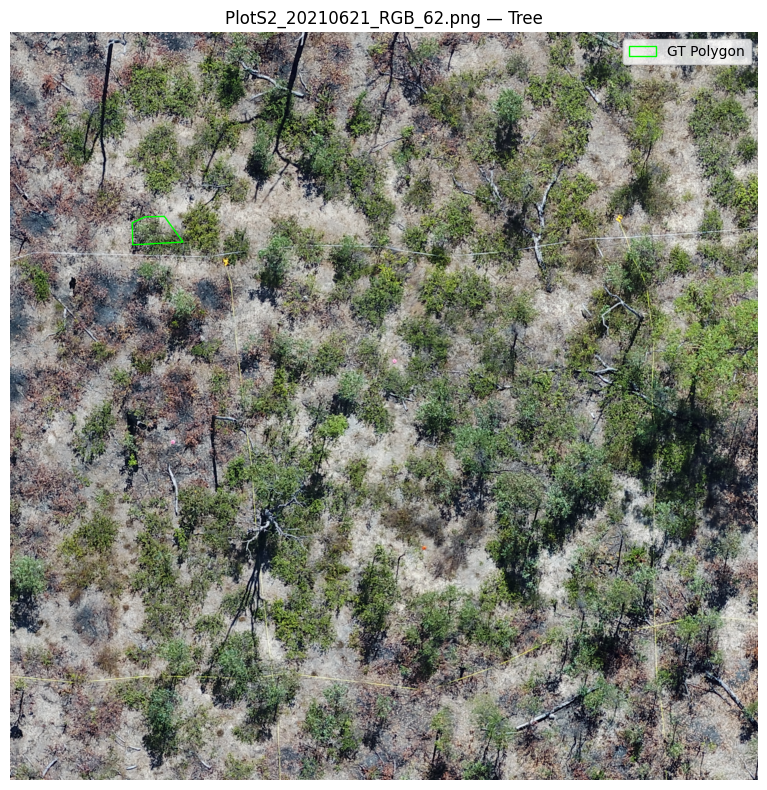

In [19]:
fig, ax = plt.subplots(figsize=(10, 8))
ax.imshow(img)
ax.set_title(f"{image_filename} — {row['label']}")

poly = patches.Polygon(coords, linewidth=1, edgecolor="lime" ,facecolor="none", label="GT Polygon")
ax.add_patch(poly)

ax.axis("off")
plt.legend()
plt.tight_layout()
plt.savefig("test.svg")
plt.show()


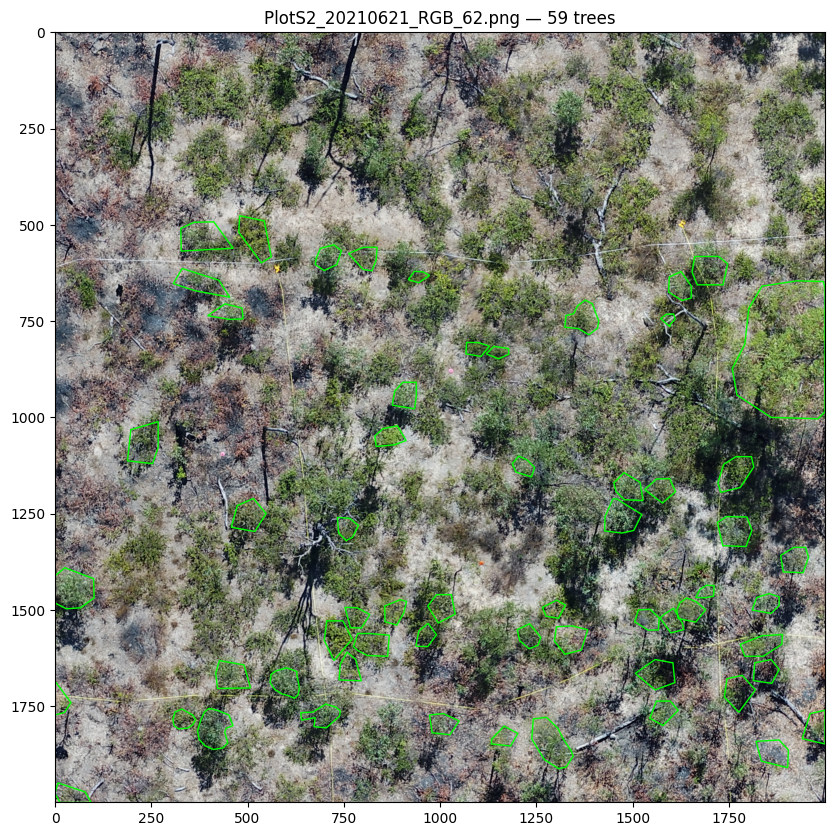

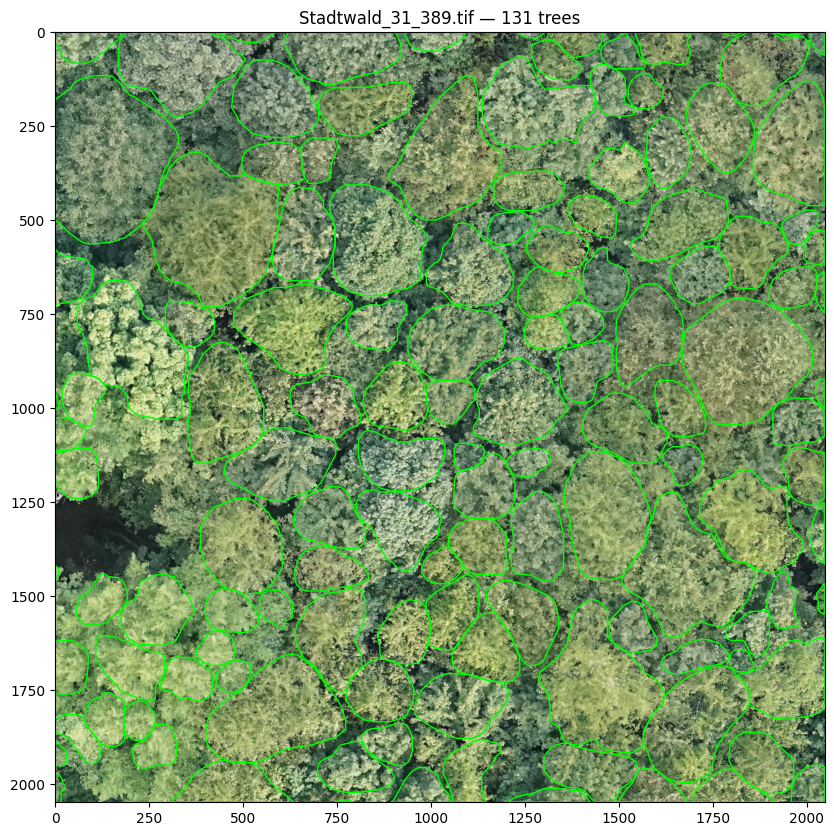

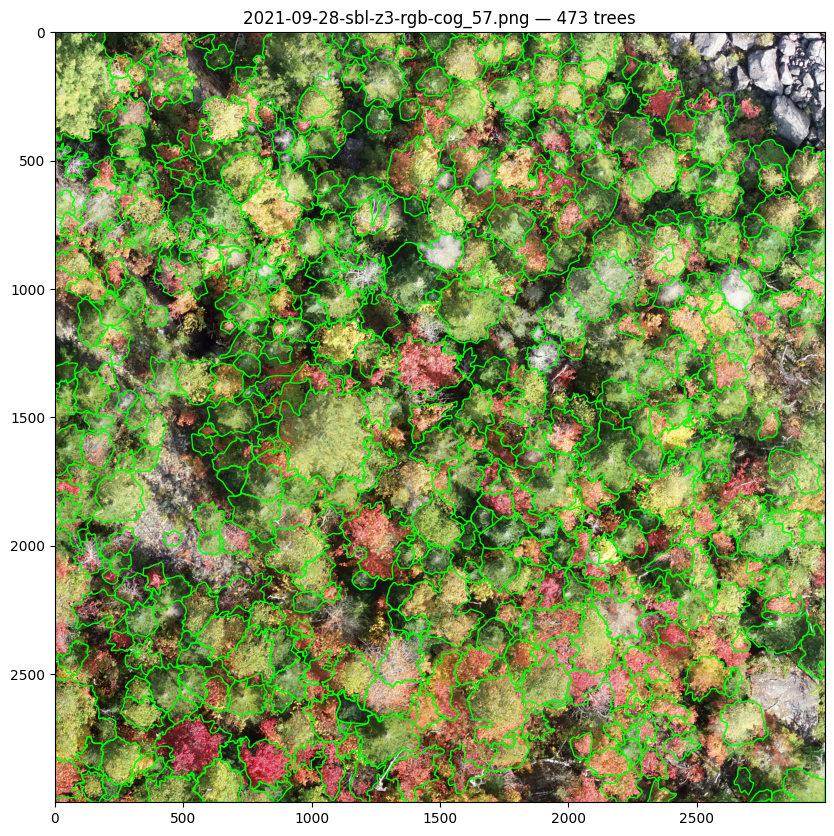

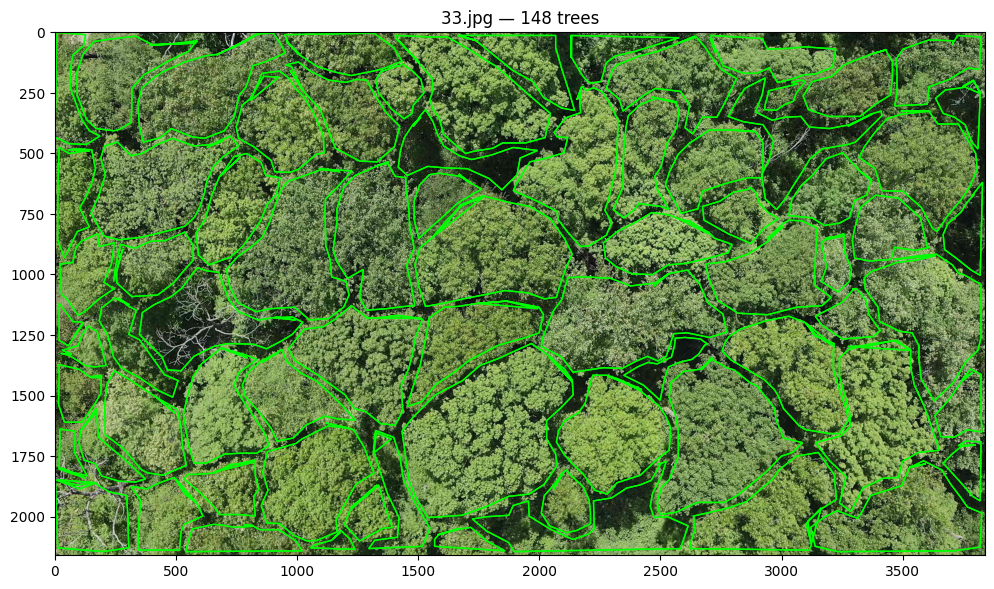

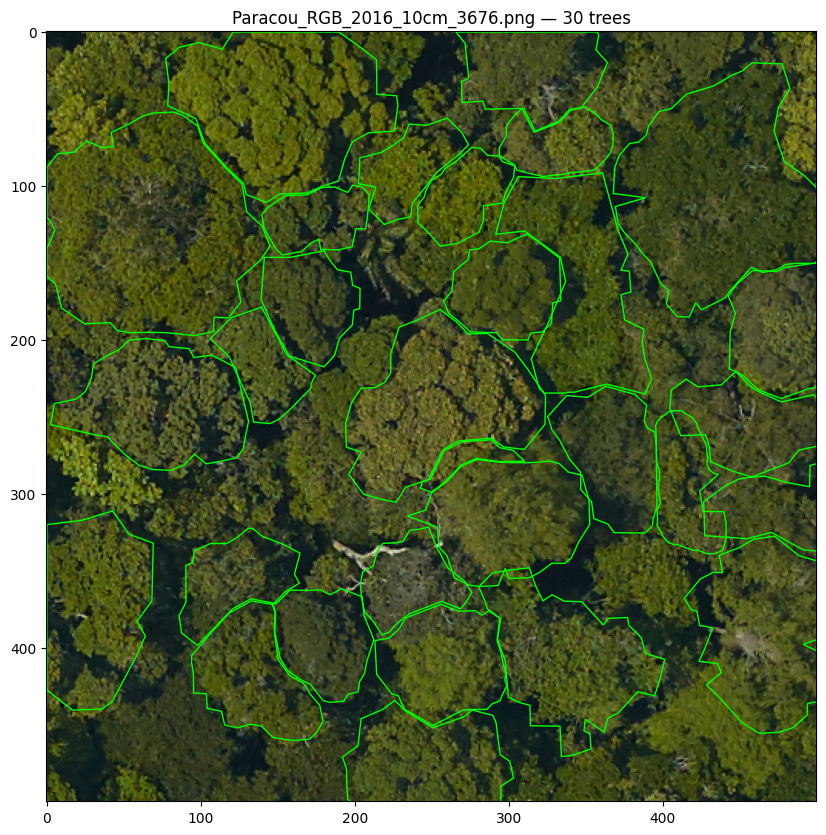

...

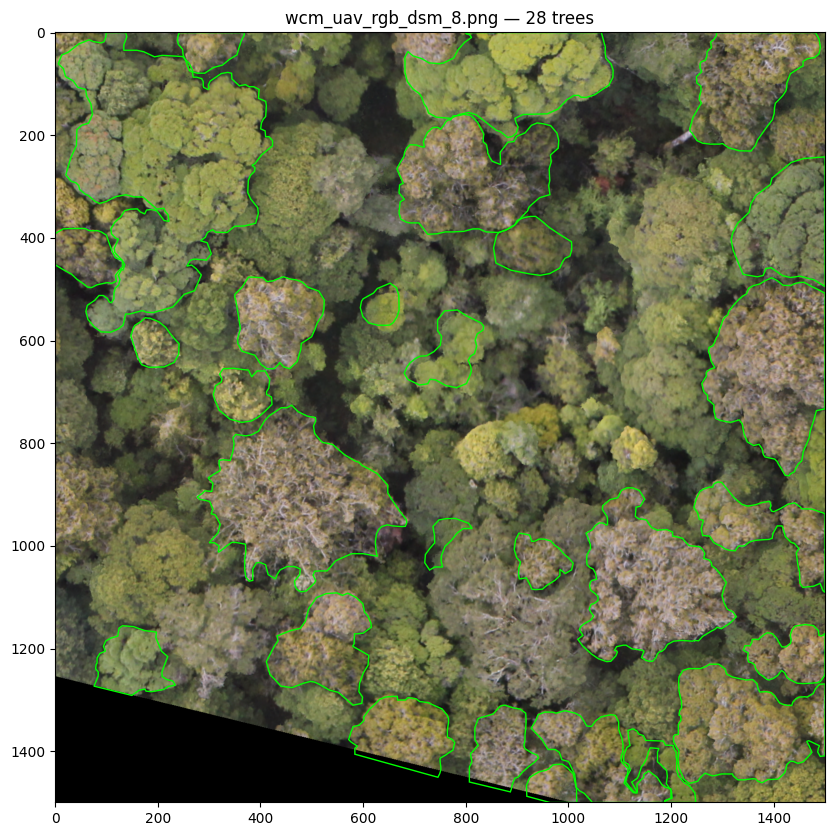

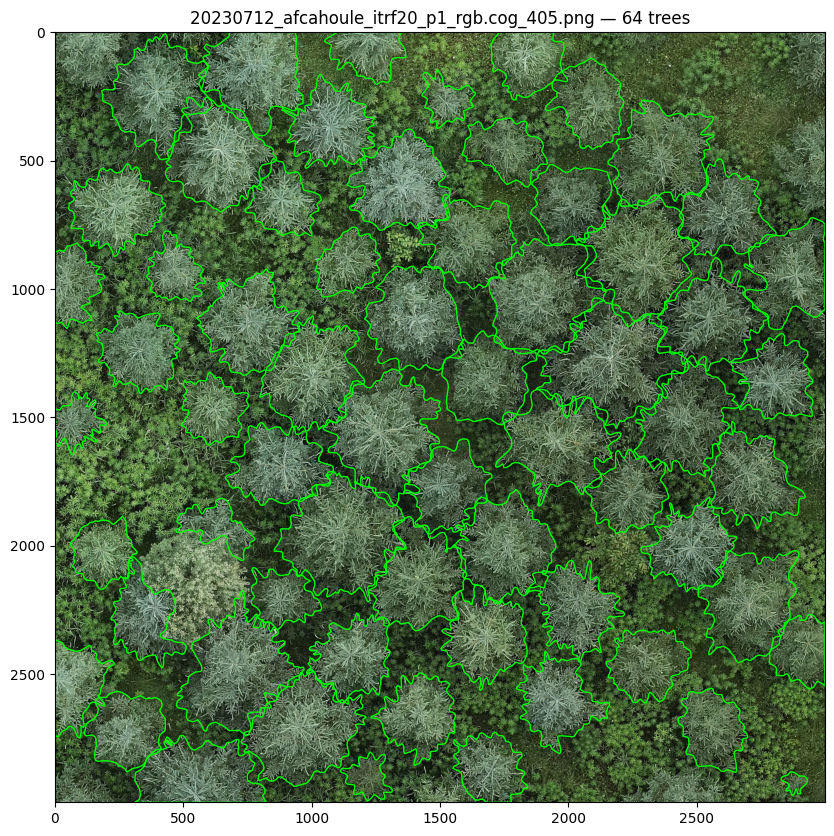

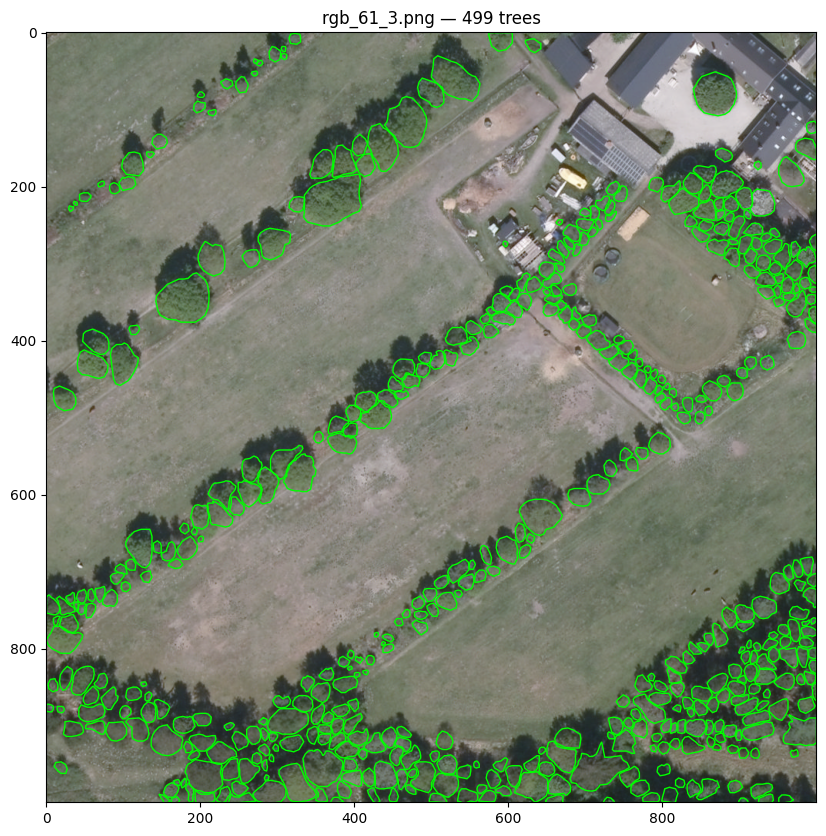

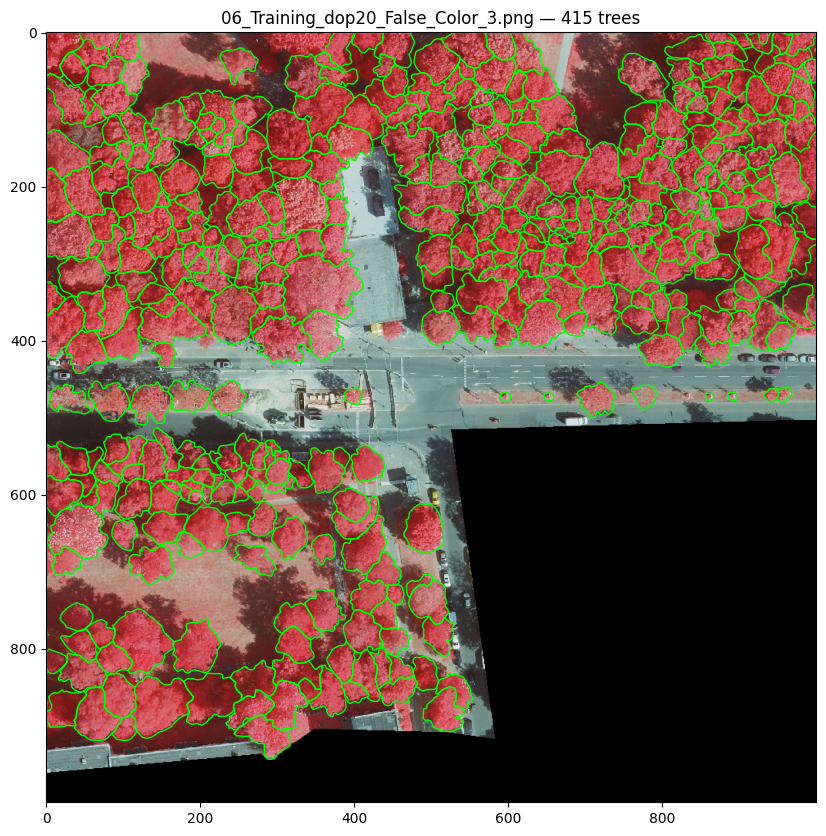

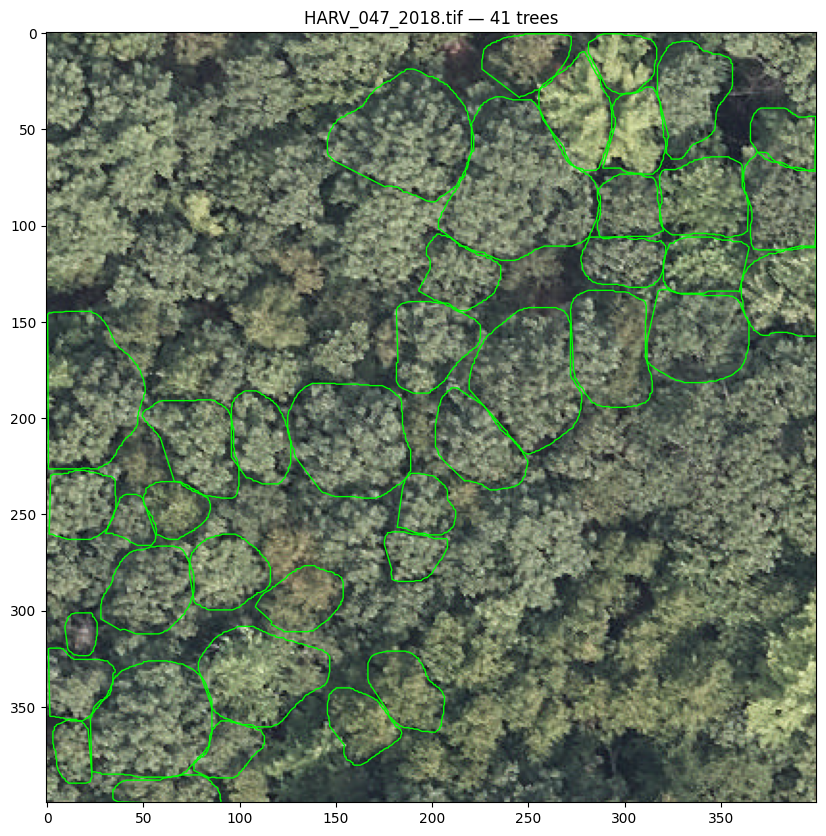

In [21]:
unique_filenames = split_df["filename"].unique()
images_dir = os.path.join("data", "TreePolygons_v0.10", "images")


for image_filename in unique_filenames:    
    image_path = os.path.join(images_dir, image_filename)
    img = plt.imread(image_path)
    
    image_rows = split_df[split_df["filename"] == image_filename]
    
    fig, ax = plt.subplots(figsize=(12, 10))
    ax.imshow(img)
    ax.set_title(f"{image_filename} — {len(image_rows)} trees")

    for idx, (_, r) in enumerate(image_rows.iterrows()):
        numbers = re.findall(r'[-+]?\d*\.\d+|[-+]?\d+', r["geometry"])
        coords = [(float(numbers[i]), float(numbers[i+1])) for i in range(0, len(numbers), 2)]
        
        poly = patches.Polygon(coords, linewidth=1, edgecolor="lime", 
                            facecolor="none")
        ax.add_patch(poly)

    #plt.savefig("test.svg")
    plt.show()
